## Initial EDA of the Electric Vehicle Charging station data

In [20]:
# libraries
import matplotlib.pyplot as plt
import pandas as pd
import folium
import seaborn as sns


In [3]:

# Load the data to see the first few rows and understand its structure
data_path = '/Users/jaskiratkaur/Documents/HPC/elec-transit-y/data/ev_stations_v1.csv'
ev_data = pd.read_csv(data_path)
ev_data.head()

/var/folders/1b/yw3h_ynn0pq2s09l1hw9zljw0000gn/T/ipykernel_17573/157320901.py:3: DtypeWarning: Columns (27,32,49,51,52,53,54,55,59,61,62) have mixed types. Specify dtype option on import or set low_memory=False.
  ev_data = pd.read_csv(data_path)


,access_code,access_days_time,access_detail_code,cards_accepted,date_last_confirmed,expected_date,fuel_type_code,groups_with_access_code,id,maximum_vehicle_class,...,rd_blends_fr,rd_max_biodiesel_level,nps_unit_name,access_days_time_fr,intersection_directions_fr,bd_blends_fr,groups_with_access_code_fr,ev_pricing_fr,federal_agency,ev_network_ids
0,public,24 hours daily; Customers must set up a PG&E a...,KEY_ALWAYS,Proprietor,2023-11-09,NaN,CNG,Public - Card key at all times,792,HD,...,NaN,NaN,NaN,NaN,NaN,NaN,Public - Carte-clé en tout temps,NaN,NaN,NaN
1,public,8am-4pm M-F; Customers must set up a PG&E acco...,KEY_ALWAYS,Proprietor,2023-10-12,NaN,CNG,Public - Card key at all times,798,LD,...,NaN,NaN,NaN,NaN,NaN,NaN,Public - Carte-clé en tout temps,NaN,NaN,NaN
2,public,24 hours daily; Customers must set up a PG&E a...,KEY_ALWAYS,Proprietor,2024-01-09,NaN,CNG,Public - Card key at all times,801,HD,...,NaN,NaN,NaN,NaN,NaN,NaN,Public - Carte-clé en tout temps,NaN,NaN,NaN
3,public,24 hours daily; Customers must set up a PG&E a...,KEY_ALWAYS,Proprietor,2024-01-09,NaN,CNG,Public - Card key at all times,806,HD,...,NaN,NaN,NaN,NaN,NaN,NaN,Public - Carte-clé en tout temps,NaN,NaN,NaN
4,public,24 hours daily; Customers must set up a PG&E a...,KEY_ALWAYS,Proprietor,2023-10-12,NaN,CNG,Public - Card key at all times,809,MD,...,NaN,NaN,NaN,NaN,NaN,NaN,Public - Carte-clé en tout temps,NaN,NaN,NaN


#### Missing Values

In [35]:

missing_values = ev_data.isnull().sum()
missing_percent = (missing_values / len(ev_data)) * 100  

# Display the results
print("Count of missing values per column:")
print(missing_values)
print("\nPercentage of missing values per column:")
print(missing_percent)


Count of missing values per column:
access_code                       0
access_days_time               3278
access_detail_code            28878
cards_accepted                25849
date_last_confirmed              57
                              ...  
groups_with_access_code_fr        0
ev_pricing_fr                 31169
federal_agency                30786
ev_network_ids                 7471
year                              0
Length: 74, dtype: int64

Percentage of missing values per column:
access_code                     0.000000
access_days_time               10.516860
access_detail_code             92.649748
cards_accepted                 82.931759
date_last_confirmed             0.182874
                                 ...    
groups_with_access_code_fr      0.000000
ev_pricing_fr                 100.000000
federal_agency                 98.771215
ev_network_ids                 23.969328
year                            0.000000
Length: 74, dtype: float64


#### Number of columns

In [5]:
num_columns = len(ev_data.columns)
print("Number of columns:", num_columns)


Number of columns: 73


#### Columns with less than 30% missing values

In [37]:
missing_percent = (ev_data.isnull().sum() / len(ev_data)) * 100
columns_with_less_than_30_percent_missing = missing_percent[missing_percent < 30].index.tolist()

print("Columns with less than 30% missing values:")
print(columns_with_less_than_30_percent_missing)


Columns with less than 30% missing values:
['access_code', 'access_days_time', 'date_last_confirmed', 'fuel_type_code', 'groups_with_access_code', 'id', 'open_date', 'status_code', 'station_name', 'station_phone', 'updated_at', 'geocode_status', 'latitude', 'longitude', 'city', 'country', 'state', 'street_address', 'zip', 'ev_connector_types', 'ev_level2_evse_num', 'ev_network', 'ev_network_web', 'ev_workplace_charging', 'groups_with_access_code_fr', 'ev_network_ids', 'year']


The EV charging station dataset contains a lot of columns, about 73 in total, which suggests it has a wide range of attributes. Here are some columns that would be interesting to explore:

**access_code**: Describes the accessibility of the station (e.g., public). 

**access_days_time**: Availability of the station throughout the week. 

**groups_with_access_code**: Access group details. 

**id**: Unique identifier for each station. 

**maximum_vehicle_class**: The maximum vehicle class that can be serviced. 



### Distribution of charging stations by fuel type and their accessibility

In [4]:
# Check for missing data in relevant columns and count the unique values in 'fuel_type_code' and 'access_code'
missing_data = ev_data[['fuel_type_code', 'access_code']].isnull().sum()
fuel_type_distribution = ev_data['fuel_type_code'].value_counts()
access_code_distribution = ev_data['access_code'].value_counts()

missing_data, fuel_type_distribution, access_code_distribution


(fuel_type_code    0
 access_code       0
 dtype: int64,
 fuel_type_code
 ELEC    27681
 E85      1065
 LPG       747
 RD        601
 BD        555
 CNG       481
 HY         95
 LNG        60
 Name: count, dtype: int64,
 access_code
 public     29567
 private     1718
 Name: count, dtype: int64)

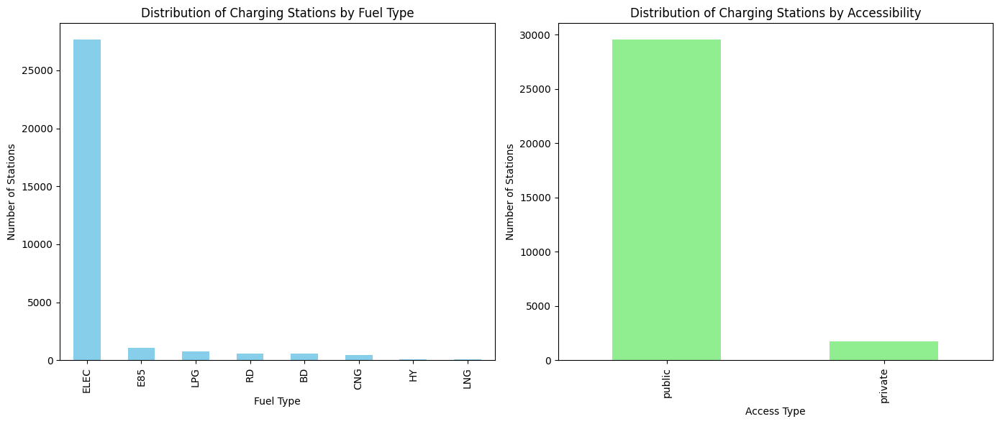

### Distribution of charging stations by state

In [25]:
# Ensure the date column is in datetime format
ev_data['open_date'] = pd.to_datetime(ev_data['open_date'], errors='coerce')

# Extract the year
ev_data['year'] = ev_data['open_date'].dt.year

# Drop rows where year is NaN
ev_data = ev_data.dropna(subset=['year'])

# Convert year to an integer
ev_data['year'] = ev_data['year'].astype(int)

/var/folders/1b/yw3h_ynn0pq2s09l1hw9zljw0000gn/T/ipykernel_17573/51570623.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ev_data['year'] = ev_data['year'].astype(int)


In [29]:
# Count the number of stations per year for each state
data_for_plotting = ev_data.groupby(['state', 'year']).size().reset_index(name='count')

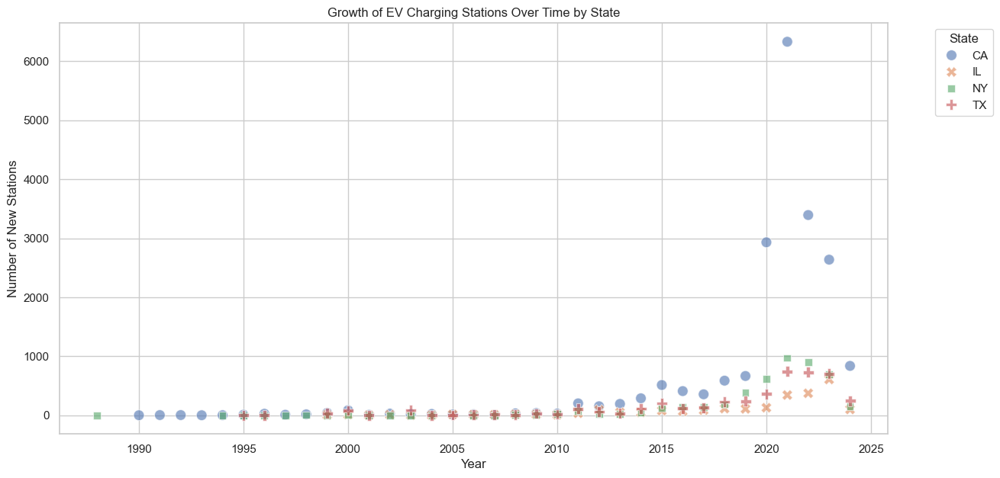

In [39]:
# Plotting the data
sns.set_theme(style="whitegrid")
plt.figure(figsize=(14, 7))
sns.scatterplot(data=data_for_plotting, x='year', y='count', hue='state', style='state', s=100, palette='deep', alpha=0.6)
plt.title('Growth of EV Charging Stations Over Time by State')
plt.xlabel('Year')
plt.ylabel('Number of New Stations')
plt.legend(title='State', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

### Cumulative count

In [32]:
# Convert the date column to datetime and extract the year
ev_data['open_date'] = pd.to_datetime(ev_data['open_date'], errors='coerce')
ev_data['year'] = ev_data['open_date'].dt.year

# Drop rows where year is NaN and convert year to an integer
ev_data = ev_data.dropna(subset=['year'])
ev_data['year'] = ev_data['year'].astype(int)

# Aggregate the data to count the number of stations per year for each state
data_for_plotting = ev_data.groupby(['state', 'year']).size().reset_index(name='count')

# Sort data to ensure cumulative sum is calculated correctly
data_for_plotting = data_for_plotting.sort_values(by=['state', 'year'])

# Calculate cumulative count
data_for_plotting['cumulative_count'] = data_for_plotting.groupby('state')['count'].cumsum()


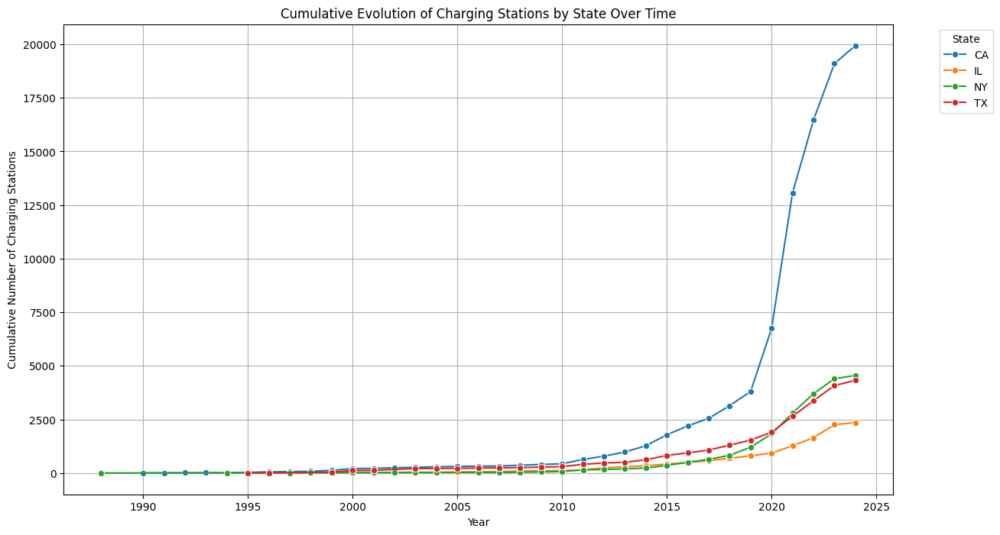

In [33]:
plt.figure(figsize=(14, 8))
sns.lineplot(data=data_for_plotting, x='year', y='cumulative_count', hue='state', marker="o")

plt.title('Cumulative Evolution of Charging Stations by State Over Time')
plt.xlabel('Year')
plt.ylabel('Cumulative Number of Charging Stations')
plt.legend(title='State', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()


### Plotting the location of Charging Stations on a map

In [40]:
latitudes = ev_data['latitude']
longitudes = ev_data['longitude']

# Create a map centered around the average location in the dataset
mean_lat, mean_lon = latitudes.mean(), longitudes.mean()
ev_map = folium.Map(location=[mean_lat, mean_lon], zoom_start=5)

# Add charging station locations to the map
for lat, lon in zip(latitudes, longitudes):
    folium.CircleMarker(
        location=[lat, lon],
        radius=3,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6
    ).add_to(ev_map)

# Show the map
ev_map